In [153]:
import pandas as pd
import slippi 

In [155]:
import enum
print(enum.__file__)

c:\Users\sigw3\AppData\Local\Programs\Python\Python37\lib\enum.py


In [154]:
import sys
import os
sys.path.append(os.path.abspath(".."))  # Ajouter le chemin absolu du projet
from src.data_processing import load_slippi_game, get_frame_data

# Charger le replay
game = load_slippi_game("../data/replays/Game_20220928T194206.slp")
print(game.frames)
# Afficher les métadonnées de base
if game:
    print(f"Durée totale : {len(game.frames)} frames")
    print(f"Stage : {game.start.stage.name}")
    print(f"Players : {[p.character.name for p in game.start.players if p]}")

[Frame(
    end=End(
    ),
    index=-123,
    items=(),
    ports=(
        Port(
            follower=None,
            leader=Data(
                post=Post(
                    airborne=True,
                    character=1:FOX,
                    combo_count=0,
                    damage=0.00,
                    direction=1:RIGHT,
                    flags=0b100000000000000000000000000000000000000:DEAD,
                    ground=None,
                    hit_stun=0.00,
                    jumps=1,
                    l_cancel=None,
                    last_attack_landed=None,
                    last_hit_by=None,
                    position=(-42.00, 26.60),
                    shield=60.00,
                    state=322:ENTRY,
                    state_age=-1.00,
                    stocks=4),
                pre=Pre(
                    buttons=Buttons(
                        logical=0b0:NONE,
                        physical=0b0:NONE),
                    cstick=(0.00, 0.

In [54]:
# Afficher les données de la frame 1200
print(game.frames[1200].ports[1])
print(dir(game.frames[1200].ports))

Port(
    follower=None,
    leader=Data(
        post=Post(
            airborne=False,
            character=7:SHEIK,
            combo_count=1,
            damage=70.38,
            direction=-1:LEFT,
            flags=0b1000100:64|4,
            ground=2,
            hit_stun=0.00,
            jumps=2,
            l_cancel=None,
            last_attack_landed=53:FORWARD_THROW,
            last_hit_by=None,
            position=(-51.19, -2.50),
            shield=60.00,
            state=14:WAIT,
            state_age=1.00,
            stocks=4),
        pre=Pre(
            buttons=Buttons(
                logical=0b0:NONE,
                physical=0b0:NONE),
            cstick=(0.00, 0.00),
            damage=(70.38),
            direction=-1:LEFT,
            joystick=(0.00, 0.00),
            position=(-51.19, -2.50),
            random_seed=78660897,
            raw_analog_x=(253),
            state=14:WAIT,
            triggers=Triggers(
                logical=0.00,
         

In [55]:
frame_number = 1200  # Frame actuelle
previous_frame_number = frame_number - 1  # Frame précédente

current_frame = game.frames[frame_number]
previous_frame = game.frames[previous_frame_number]

for port, port_data in enumerate(current_frame.ports):
    if port_data is None or game.start.players[port] is None:
        continue  # Port inutilisé ou données manquantes

    current_position = port_data.leader.post.position
    previous_position = previous_frame.ports[port].leader.post.position

    velocity_x = current_position.x - previous_position.x
    velocity_y = current_position.y - previous_position.y

    print(f"Port {port} - Vélocité : ({velocity_x}, {velocity_y})")

Port 0 - Vélocité : (-0.9730911254882812, -2.0871849060058594)
Port 1 - Vélocité : (0.0, 0.0)


In [104]:
import importlib
from src import data_processing
importlib.reload(data_processing)
from src.data_processing import load_slippi_game, get_frame_data

frame_number = 3100 # Numéro de la frame à analyser (0 pour la première frame)

# Conversion de la frame en DataFrame
frame_data = get_frame_data(game, frame_number)

# Utilisation de pandas pour normaliser et convertir les données de la frame en DataFrame
df = pd.json_normalize(
    frame_data['players'],  # Extraction des données des joueurs
    sep='_' # Séparateur pour les colonnes imbriquées
).transpose()  # Transposition pour une meilleure lisibilité

# Affichage du DataFrame
df

,0
0_character,FOX
0_position,"(64.51622009277344, -13.64989948272705)"
0_percentage,80.839996
0_state,DASH
0_shield,60.0
0_velocity,"(-0.035308837890625, 0.0)"
1_character,SHEIK
1_position,"(34.43044662475586, 9.999999747378752e-05)"
1_percentage,0.0
1_state,WALK_MIDDLE


In [105]:
# Remplacez par une frame où vous savez qu'un joueur est invincible/intangible
frame = game.frames[frame_number]

for port, port_data in enumerate(frame.ports):
    if port_data and port_data.leader:
        flags = port_data.leader.post.flags
        print(f"Port {port} - Flags: {bin(flags)}")

Port 0 - Flags: 0b0
Port 1 - Flags: 0b1000100


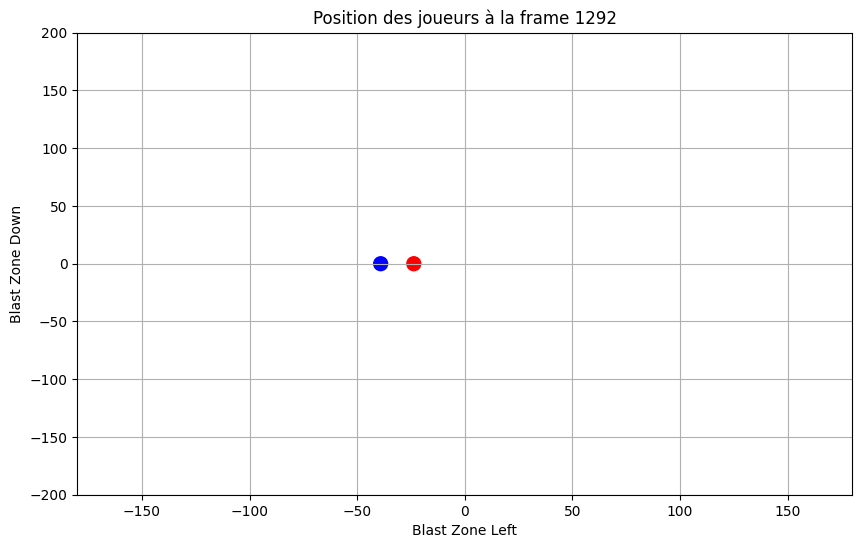

In [ ]:
import matplotlib.pyplot as plt

positions = [p['position'] for p in frame_data['players'].values()]
x, y = zip(*positions)
plt.figure(figsize=(10, 6))
plt.xlabel('Blast Zone Left')
plt.ylabel('Blast Zone Down')
plt.scatter(x, y, c=['blue', 'red'], s=100)
plt.title(f"Position des joueurs à la frame {frame_number}")
plt.xlim(-180, 180)  # Adapté selon le stage (ici, yoshis story)
plt.ylim(-200, 200)
plt.grid()
plt.show()

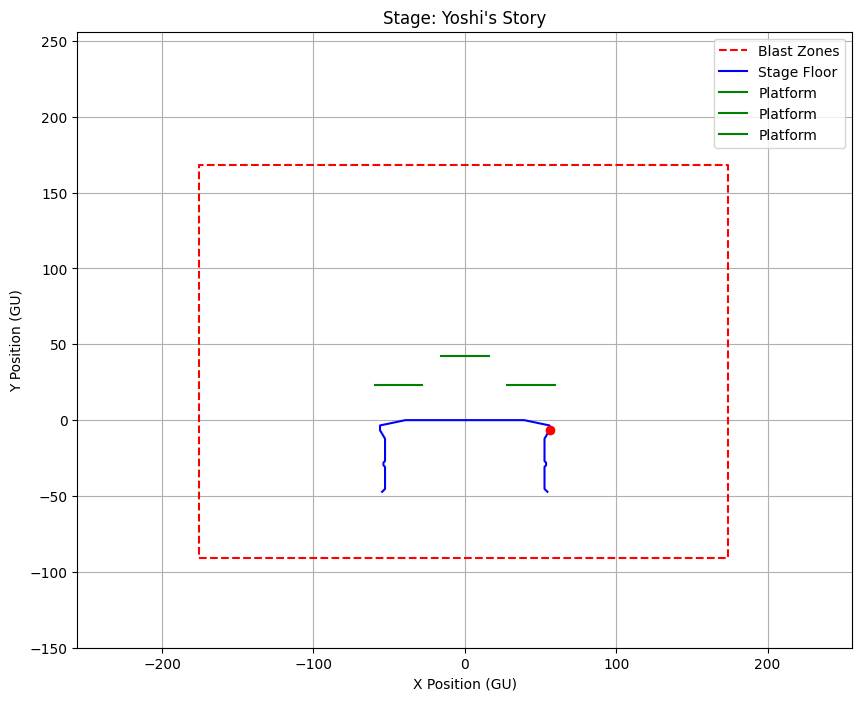

In [ ]:

# Stage data sous la forme d'un dictionnaire
# Chaque stage a des zones de blast, des limites de scène et des plateformes
# Stage data mis à jour
stages = {
    "Yoshi's Story": {
        "blast_zones": (-175.70, 173.60, 168.00, -91.00),  # Dead0N et Dead1N
        "stage_floor": [
            (-54.6000, -47.2450), (-52.6750, -45.3200), (-52.6750, -30.8000),
            (-53.7250, -29.7500), (-53.7250, -28.0000), (-52.6750, -26.9500),
            (-52.6750, -12.2500), (-56.0000, -6.6500), (-56.0000, -3.5000),
            (-39.2000, 0.0000), (39.2000, 0.0000), (56.0000, -3.5000),
            (56.0000, -6.6500), (52.6750, -12.2500), (52.6750, -26.9500),
            (53.7250, -28.0000), (53.7250, -29.7500), (52.6750, -30.8000),
            (52.6750, -45.3200), (54.6000, -47.2450)
        ],
        "platforms": [
            ((-15.75, 42.00), (15.75, 42.00)),  # Top platform
            ((-59.50, 23.45), (-28.00, 23.45)),  # Left platform
            ((28.00, 23.45), (59.50, 23.45))  # Right platform
        ],
        "ledges": [ ((-56.0000, -6.6500) ,(56.0000, -6.6500))] # Ledges
    },
    "Final Destination": {
        "blast_zones": (-246.00, 246.00, 188.00, -140.00),  # Dead0N et Dead1N
        "stage_floor": [
            (-47.4702, -55.3870), (-53.7742, -54.2572), (-61.4170, -47.3683),
            (-65.8426, -31.3573), (-65.7957, -20.4538), (-85.5606, -10.5094),
            (-85.5606, 0.0000), (85.5606, 0.0000), (85.5606, -10.5094),
            (65.7957, -20.4538), (65.8426, -31.3573), (61.4170, -47.3683),
            (53.7742, -54.2572), (47.4702, -55.3870)
        ],
        "platforms": [], # Pas de plateformes
        "ledges": [(( -85.5606, 0.0000) , (85.5606, 0.0000))] # Ledges
    },
    "Fountain of Dreams": {
        "blast_zones": (-198.75, 198.75, 202.50, -146.25),  # Dead0N et Dead1N
        "stage_floor": [
            (-8.6809, -71.8312), (-18.9105, -48.6670), (-41.1778, -41.9127),
            (-56.8736, -19.5537), (-63.2570, -4.3985), (-63.3500, 0.6214),
            (-53.5835, 0.6214), (-51.2608, 0.0000), (51.2608, 0.0000),
            (53.5835, 0.6214), (63.3500, 0.6214), (63.2570, -4.3985),
            (56.8736, -19.5537), (41.1778, -41.9127), (18.9105, -48.6670),
            (8.6809, -71.8312)
        ],
        "platforms": [
            ((-14.25, 42.75), (14.25, 42.75)),  # Top platform
            ((-49.50, 27.375), (-21.00, 27.375)),  # Left highest
            ((-49.50, 16.125), (-21.00, 16.125)),  # Left start
            ((-49.50, 12.375), (-21.00, 12.375)),  # Left lowest
            ((21.00, 27.375), (49.50, 27.375)),  # Right highest
            ((21.00, 22.125), (49.50, 22.125)),  # Right start
            ((21.00, 12.375), (49.50, 12.375))  # Right lowest
        ]
    },
    "Dream Land 64": {
        "blast_zones": (-255.00, 255.00, 250.00, -123.00),  # Dead0N et Dead1N
        "stage_floor": [
            (-65.7610, -35.7543), (-76.3364, -11.0418), (-77.2700, 0.0100),
            (77.2700, 0.0100), (76.3364, -11.0418), (65.7610, -35.7543)
        ],
        "platforms": [
            ((-19.0188, 51.4264), (19.0188, 51.4264)),  # Top platform
            ((-61.3896, 30.1422), (-31.7215, 30.1422)),  # Left platform
            ((31.7051, 30.2425), (63.0764, 30.2425))  # Right platform
        ]
    },
    "Battlefield": {
        "blast_zones": (-224.00, 224.00, 200.00, -108.80),  # Dead0N et Dead1N
        "stage_floor": [
            (-68.4000, 0.0000), (68.4000, 0.0000)
        ],
        "platforms": [
            ((-18.80, 54.40), (18.80, 54.40)),  # Top platform
            ((-57.60, 27.20), (-20.00, 27.20)),  # Left platform
            ((20.00, 27.20), (57.60, 27.20))  # Right platform
        ]
    },
    "Pokemon Stadium": {
        "blast_zones": (-240.00, 240.00, 180.00, -111.00),  # Dead0N et Dead1N
        "stage_floor": [
            (-105.00, 00.00), (-90.00, 00.00), (-75.00, 00.00), (-60.00, 00.00),
            (-45.00, 00.00), (-30.00, 00.00), (-15.00, 00.00), (0.00, 00.00),
            (15.00, 00.00), (30.00, 00.00), (45.00, 00.00), (60.00, 00.00),
            (75.00, 00.00), (90.00, 00.00), (105.00, 00.00)
        ],
        "platforms": [
            ((-67, 35), (-29.00, 35)),  # Left platform
            ((29.00, 35), (67, 35))  # Right platform
        ]
    }
}


import matplotlib.pyplot as plt

def draw_stage(stage_name):
    """
    Dessine un stage parmi les 6 stages légaux en utilisant matplotlib.
    
    Args:
        stage_name (str): Le nom du stage (parmi "Yoshi's Story", "Final Destination",
                          "Fountain of Dreams", "Dream Land 64", "Battlefield").
    """
    if stage_name not in stages:
        print(f"Stage '{stage_name}' non trouvé !")
        return

    stage = stages[stage_name]
    blast_zones = stage["blast_zones"]
    stage_floor = stage["stage_floor"]
    platforms = stage["platforms"]

    # Création de la figure
    fig, ax = plt.subplots(figsize=(10, 8))

    # Dessiner les blast zones
    ax.plot(
        [blast_zones[0], blast_zones[1], blast_zones[1], blast_zones[0], blast_zones[0]],
        [blast_zones[3], blast_zones[3], blast_zones[2], blast_zones[2], blast_zones[3]],
        label="Blast Zones",
        color="red",
        linestyle="--"
    )

    # Dessiner le sol principal
    stage_floor_x = [point[0] for point in stage_floor]
    stage_floor_y = [point[1] for point in stage_floor]
    ax.plot(stage_floor_x, stage_floor_y, label="Stage Floor", color="blue")

    # Dessiner les plateformes comme des segments entre deux points
    for platform in platforms:
        (x1, y1), (x2, y2) = platform
        ax.plot(
            [x1, x2],  # Segment horizontal
            [y1, y2],
            label="Platform",
            color="green"
        )
    ax.plot(56.0000, -6.6500, marker='o', color='red')
    # Configurer les limites de l'affichage
    ax.set_xlim(-256.00, 256)
    ax.set_ylim(-150, 256)
#(-255.00, 255.00, 250.00, -123.00)
    # Ajouter des labels, une légende et une grille
    ax.set_title(f"Stage: {stage_name}")
    ax.set_xlabel("X Position (GU)")
    ax.set_ylabel("Y Position (GU)")
    ax.legend()
    ax.grid()

    # Afficher la figure
    plt.show()
# Example: Draw Battlefield
draw_stage("Yoshi's Story")

In [59]:
frame = game.frames[3915]  # Replace with a frame where the player is invincible
port_data = frame.ports[0]  # Replace with the correct port
if port_data and port_data.leader:
    flags = port_data.leader.post.flags
    print(f"Flags: {bin(flags)}")  # Print the flags in binary format

Flags: 0b100000000000


In [187]:

import importlib
from src import feature_extraction
importlib.reload(feature_extraction)
from src.feature_extraction import extract_game_features

# Extraire les fonctionnalités pour la frame 1200
features = extract_game_features(game, 1200, feature_groups=['basic'])
features_df = pd.DataFrame([features])

# Afficher le DataFrame
print(features_df)

   p0_position_x  p0_position_y  p1_position_x  p1_position_y  p0_damage  \
0     -99.794006     -29.718788     -51.193314      -2.498507      49.84   

   p1_damage  p0_state_DAMAGE_FLY_N  p1_state_WAIT  p0_shield  p1_shield  \
0  70.380005                    1.0            1.0       60.0       60.0   

   p0_velocity_x  p0_velocity_y  p1_velocity_x  p1_velocity_y  
0      -0.973091      -2.087185            0.0            0.0  


In [188]:
from config.constants import Stage

def is_on_platform(position, stage: Stage):
    x, y = position
    for (x1, y1), (x2, y2) in stage.platforms:
        if (x1 <= x <= x2) and abs(y - y1) < 5:  # 5 unités de marge
            return True
    return False

ImportError: cannot import name 'Stage' from 'config.constants' (c:\Users\sigw3\OneDrive\Documents\alphamelee-project\config\constants.py)